In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

In [3]:
df=pd.read_csv(r'C:\Users\SA70009504\Music\final_df2.csv')


### Each feature - EDA

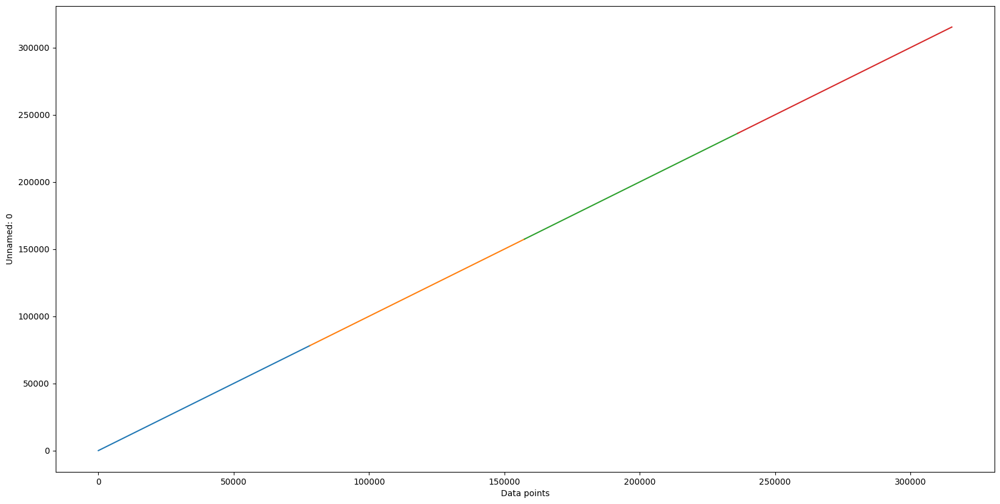

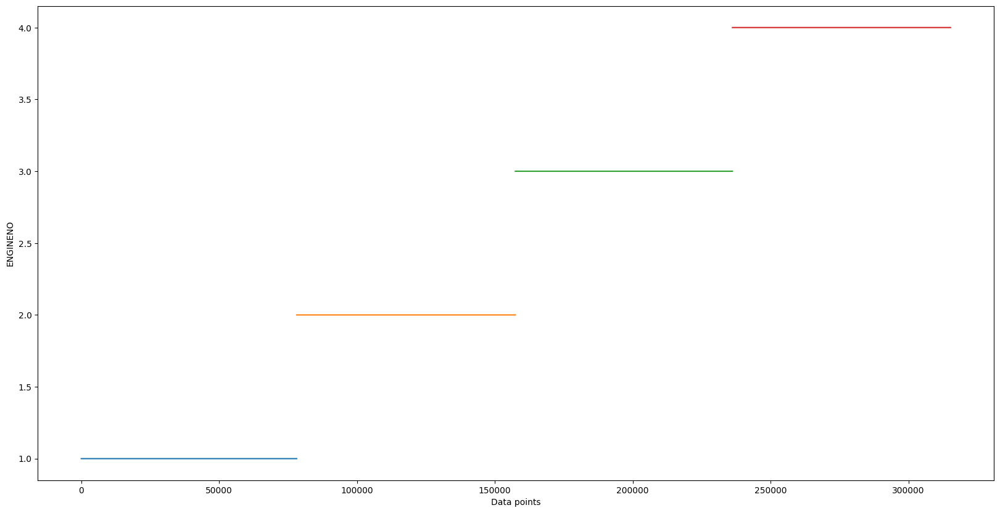

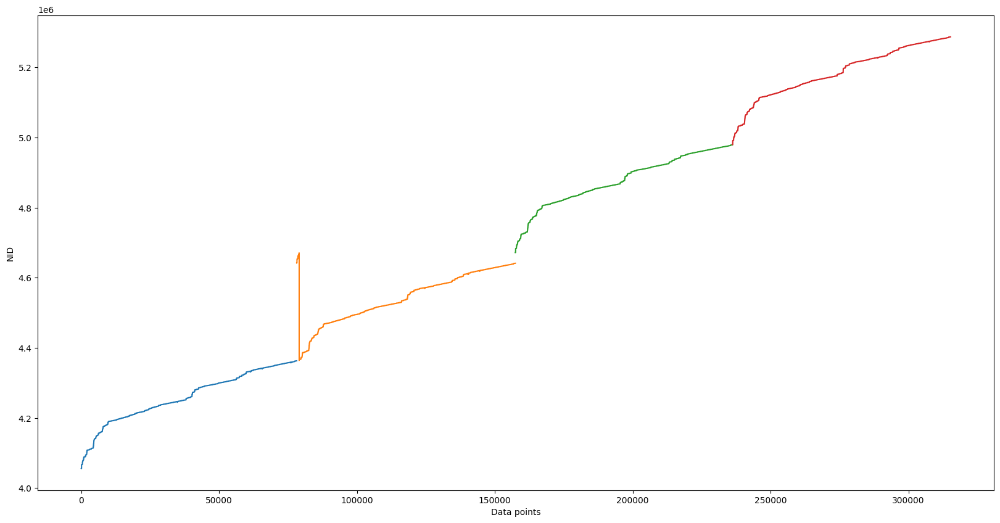

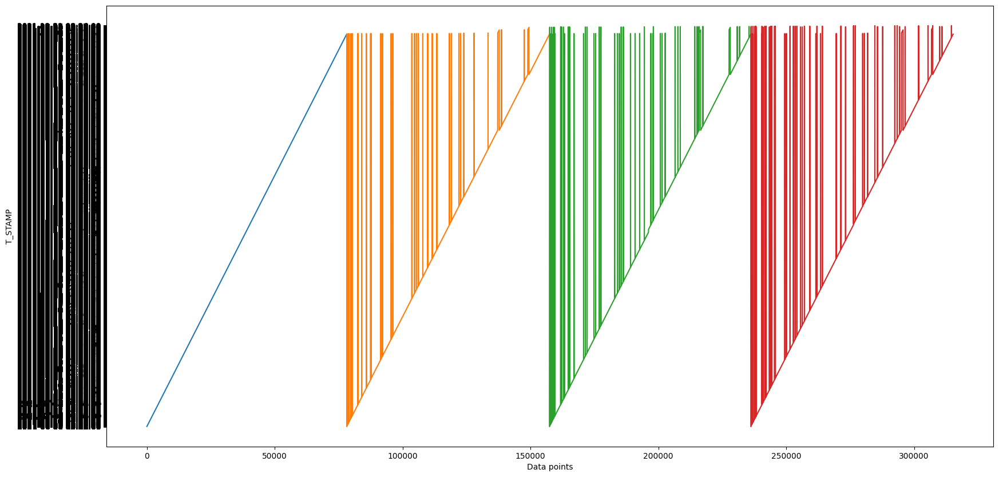

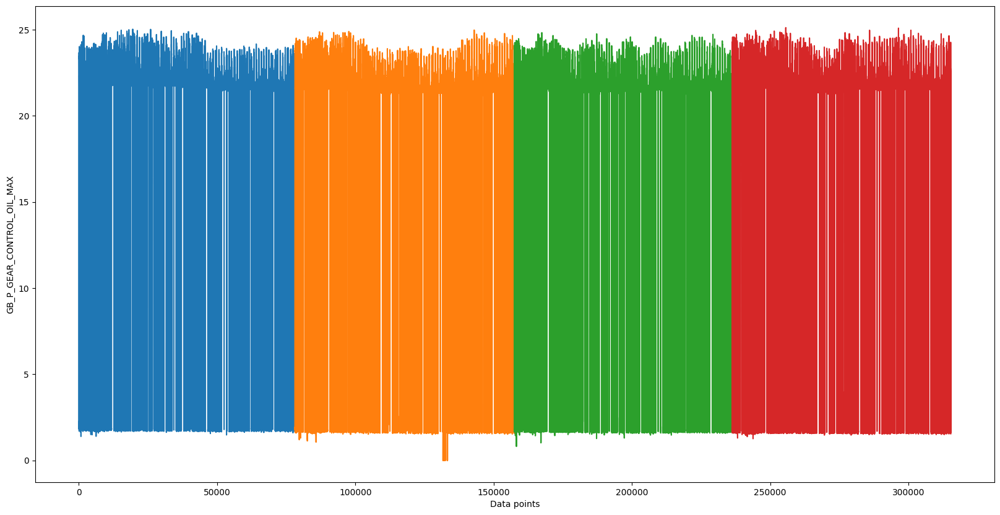

...

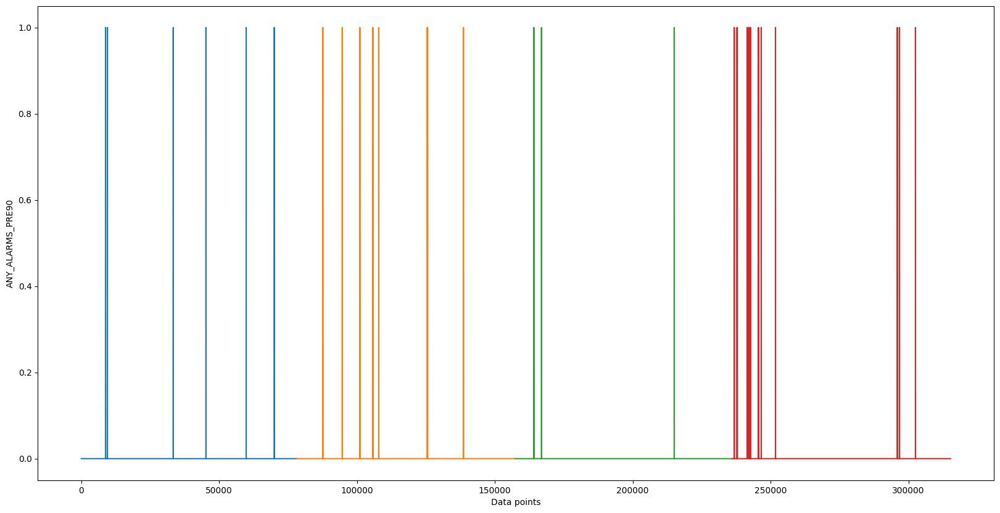

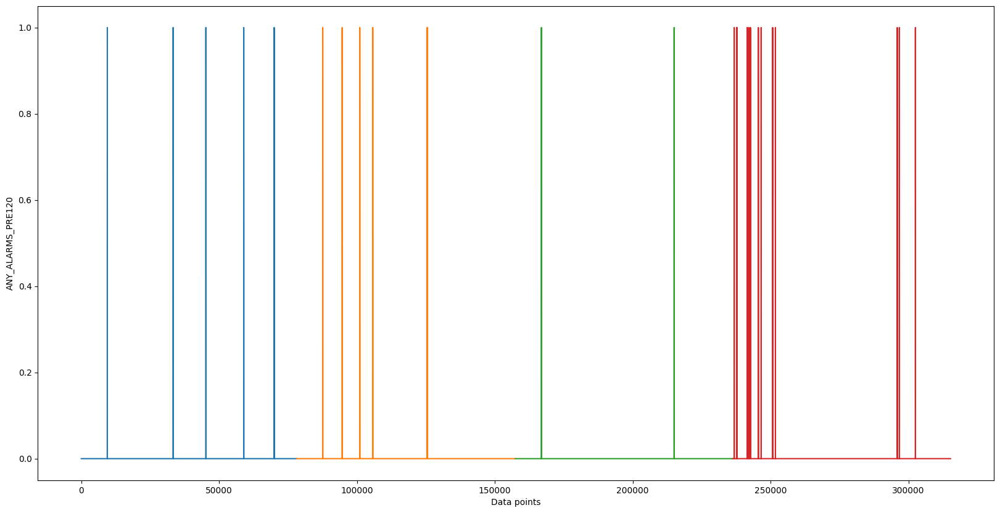

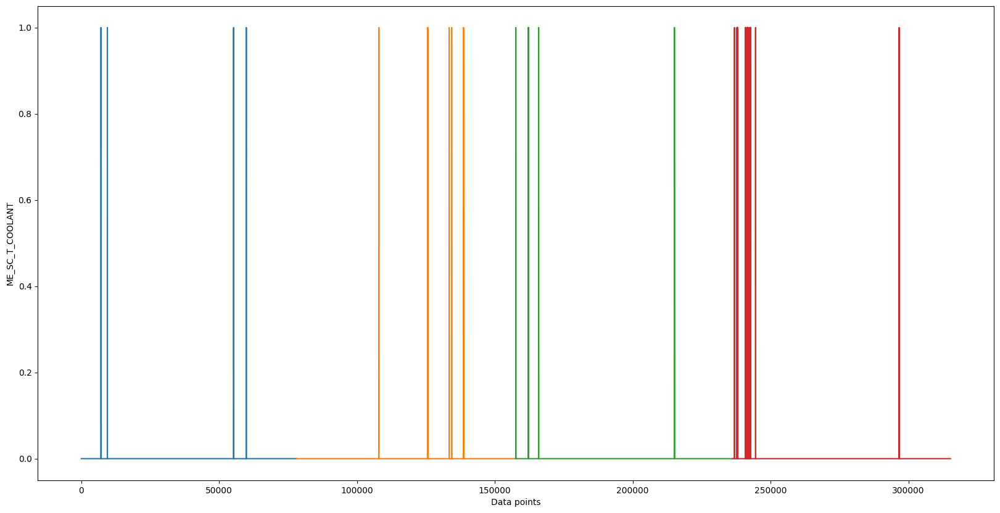

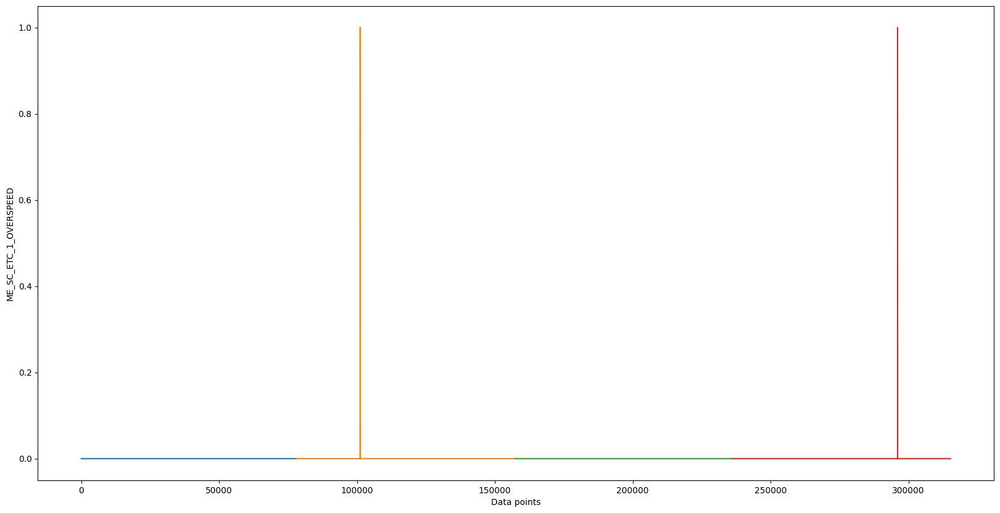

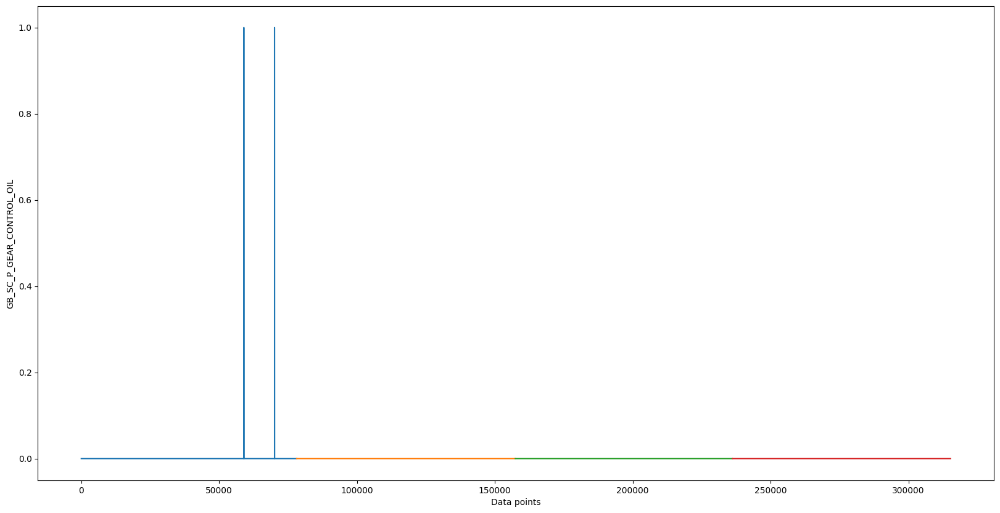

OSError: [Errno 22] Invalid argument: 'C:\\Users\\SA70009504\\Music\\EDA\\ME* HIHI T-Coolant_verifieda.png'

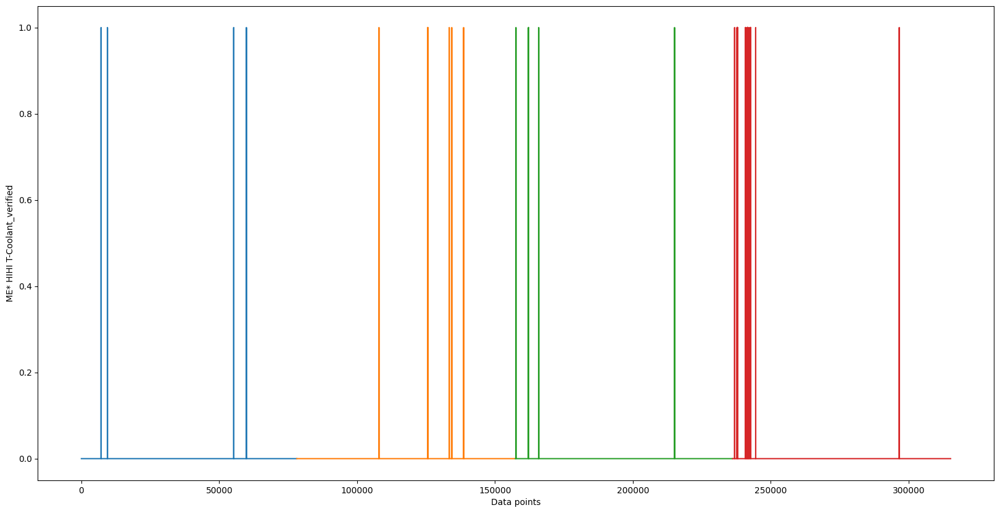

In [19]:
for i in df.columns:
    fig, ax1 = plt.subplots(figsize=(20, 10))
    ax1.plot(df[i][:78129]) #engine 1
    ax1.plot(df[i][78129:157426]) #engine 2
    ax1.plot(df[i][157426:236179]) #engine 3
    ax1.plot(df[i][236179:]) #engine 4
    ax1.set(xlabel="Data points", ylabel= i)
    plt.savefig('C:\\Users\\SA70009504\\Music\\EDA\\'+i+"a.png")
    plt.show()


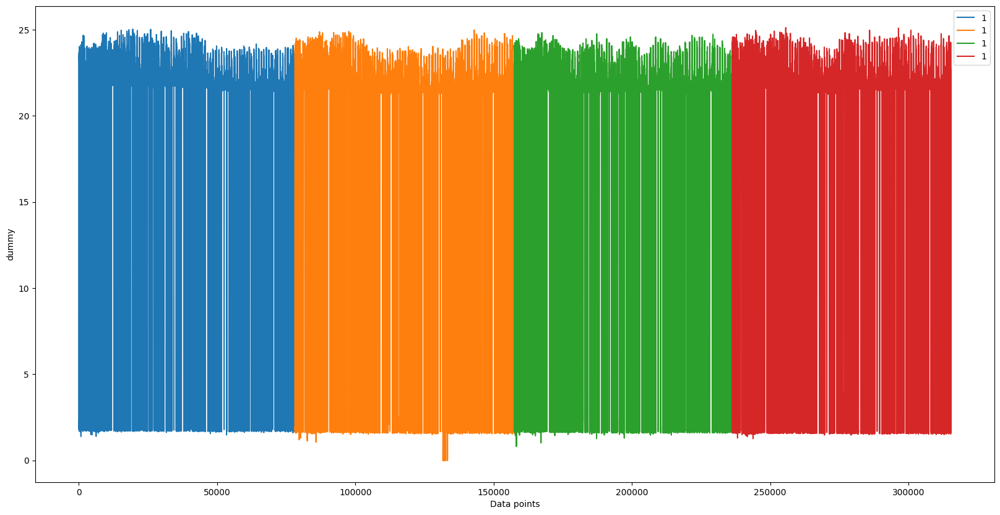

In [18]:
df.groupby(['ENGINENO'])['Unnamed: 0'].max()
fig, ax1 = plt.subplots(figsize=(20, 10))
ax1.plot(df['GB_P_GEAR_CONTROL_OIL_MAX'][:78129])
ax1.plot(df['GB_P_GEAR_CONTROL_OIL_MAX'][78129:157426])
ax1.plot(df['GB_P_GEAR_CONTROL_OIL_MAX'][157426:236179])
ax1.plot(df['GB_P_GEAR_CONTROL_OIL_MAX'][236179:])

ax1.set(xlabel="Data points", ylabel= 'dummy')
ax1.legend(df['ENGINENO'])
plt.savefig('C:\\Users\\SA70009504\\Music\\EDA\\'+"a.png")
plt.show()



### LPF

In [21]:
from scipy.signal import butter,filtfilt,freqz
import scipy.fftpack
import plotly.graph_objects as go 
import plotly.express as px
import plotly as plt

import plotly.offline as pyo
pyo.init_notebook_mode()
import plotly.io as pio
pio.renderers
pio.renderers.default = "notebook"



In [62]:

# Filter requirements.
T = 78000.0         # Sample Period
fs = 1          # sample rate, Hz - 0.0167 (since this 1 record for a min i.e. 1/60)
cutoff = 0.0003   # desired cutoff frequency of the filter, Hz ,      slightly higher than actual 1.2 Hz
nyq = 0.5 * fs  # Nyquist Frequency
order = 2      # sin wave can be approx represented as quadratic
n = int(T * fs) # total number of samples
t = np.arange(0,78000,1)

data=df['ME_ENGINE_SPEED_CRANKSHAFT_MAX']
data=np.array(data)
data

def butter_lowpass_filter(data, cutoff, fs, order):
    normal_cutoff = cutoff / nyq
    # Get the filter coefficients 
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    y = filtfilt(b, a, data)
    return y



In [63]:
# Filter the data, and plot both the original and filtered signals.
y = butter_lowpass_filter(data, cutoff, fs, order)
fig = go.Figure()
link_size = [1,2]
fig.add_trace(go.Scatter(
            y = data,
            line =  dict(shape =  'spline' ),
            name = 'signal with noise'
            ))
fig.add_trace(go.Scatter(
            y = y,
            line =  dict(shape =  'spline',width=2),
            name = 'filtered signal',
            ))
plt.offline.plot(fig, filename = '0.0003-cutoff-ME_ENGINE_SPEED_CRANKSHAFT_MAX.html', auto_open = False)

'0.0003-cutoff-ME_ENGINE_SPEED_CRANKSHAFT_MAX.html'

In [14]:
y = butter_lowpass_filter(data, cutoff, fs, order)
fig = go.Figure()
fig.add_trace(go.Scatter(
            y = data,
            line =  dict(shape =  'spline' ),
            name = 'signal with noise - Diff_Pr'
            ))
fig.add_trace(go.Scatter(
            y = y,
            line =  dict(shape =  'spline' ),
            name = 'filtered signal - Diff_Pr'
            ))

fig.add_trace(go.Scatter(
            y = df['remaining_cycle'],
            line =  dict(shape =  'spline',color='black',width=0.5),
            name = 'unfiltered signal - Pressure'
            ))
fig.show()